In [7]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report,confusion_matrix
from sklearn import decomposition
from sklearn.preprocessing import OneHotEncoder
import matplotlib.pyplot as plt
import pandas as pd
import calendar
import sklearn.preprocessing as pre_processing
from sklearn.preprocessing import LabelEncoder
import seaborn as sns
import os
import numpy as np
from matplotlib.font_manager import *
plt.rcParams['font.sans-serif'] = ['SimHei']  # 用黑体显示中文
plt.rcParams['axes.unicode_minus'] = False   #解决保存图像是负号‘-’显示为方块的问题
sns.set(font='SimHei') #解决Seaborn中文显示问题
%matplotlib inline

In [8]:
os.getcwd()

'E:\\货车油耗预测\\can-GPS 论文\\单车日报表\\.ipynb_checkpoints'

In [147]:
for day in range(1,32):
    datasets = pd.read_excel('..\【07%s】单车日报表.xlsx' % day)
    datasets['日期y/m/d'] = np.nan
    datasets['日期y/m/d'] = datasets['日期y/m/d'].fillna( '07%s' % day)
    datasets.to_excel('.\【07%s】单车日报表.xlsx' % day, index=False)
    
    
    
    
    
    

In [148]:
for day in range(1,32):
    datasets = pd.read_excel('..\【08%s】单车日报表.xlsx' % day)
    datasets['日期y/m/d'] = np.nan
    datasets['日期y/m/d'] = datasets['日期y/m/d'].fillna( '08%s' % day)
    datasets.to_excel('.\【08%s】单车日报表.xlsx' % day, index=False)
    

In [149]:
for day in range(10,31):
    datasets = pd.read_excel('..\【09%s】单车日报表.xlsx' % day)
    datasets['日期y/m/d'] = np.nan
    datasets['日期y/m/d'] = datasets['日期y/m/d'].fillna( '09%s' % day)
    datasets.to_excel('.\【09%s】单车日报表.xlsx' % day, index=False)
    

In [150]:
for mon in range(7,10):
    if mon < 9:
        for day in range(calendar.mdays[8] + 1):
            if day == 0:
                del day
            else:
                datasets = pd.read_excel('..\【0%s%s】单车日报表.xlsx' %  (mon,day))
                print('%s月の第%s天の维度'% (mon,day) + str(datasets.shape))
    else:
        for day in range(calendar.mdays[9] + 1):
            if day == 0:
                del day
            else:
                if day <10:
                    datasets = pd.read_excel('..\【0%s0%s】单车日报表.xlsx' %  (mon,day))
                    print('%s月の第%s天の维度'% (mon,day) + str(datasets.shape))
                    day += 1
                else:
                    datasets = pd.read_excel('..\【0%s%s】单车日报表.xlsx' %  (mon,day))
                    print('%s月の第%s天の维度'% (mon,day) + str(datasets.shape))
    
                    

7月の第1天の维度(3031, 68)
7月の第2天の维度(3031, 68)
7月の第3天の维度(3031, 68)
7月の第4天の维度(3031, 68)
7月の第5天の维度(3031, 68)
7月の第6天の维度(3031, 68)
7月の第7天の维度(3031, 68)
7月の第8天の维度(3031, 68)
7月の第9天の维度(3031, 68)
7月の第10天の维度(3031, 68)
7月の第11天の维度(3031, 68)
7月の第12天の维度(3031, 68)
7月の第13天の维度(3031, 68)
7月の第14天の维度(3031, 68)
7月の第15天の维度(3031, 68)
7月の第16天の维度(3031, 68)
7月の第17天の维度(3031, 68)
7月の第18天の维度(3031, 68)
7月の第19天の维度(3031, 68)
7月の第20天の维度(3031, 68)
7月の第21天の维度(3031, 68)
7月の第22天の维度(3031, 68)
7月の第23天の维度(3031, 68)
7月の第24天の维度(3031, 68)
7月の第25天の维度(3031, 68)
7月の第26天の维度(3031, 68)
7月の第27天の维度(3031, 70)
7月の第28天の维度(3031, 70)
7月の第29天の维度(3031, 70)
7月の第30天の维度(3031, 70)
7月の第31天の维度(3031, 70)
8月の第1天の维度(3031, 70)
8月の第2天の维度(3031, 68)
8月の第3天の维度(3031, 68)
8月の第4天の维度(3031, 68)
8月の第5天の维度(3031, 68)
8月の第6天の维度(3031, 68)
8月の第7天の维度(3031, 68)
8月の第8天の维度(3031, 68)
8月の第9天の维度(3031, 68)
8月の第10天の维度(3031, 68)
8月の第11天の维度(3031, 68)
8月の第12天の维度(3031, 68)
8月の第13天の维度(3031, 68)
8月の第14天の维度(3031, 68)
8月の第15天の维度(3031, 68)
8月の第16天の维度(3031, 68)
8月の第17天の维度(3031, 68)
8月の第18天の维度

In [151]:
#合并所有的文件
df_conbine = pd.DataFrame()
for mon in range(7,10):
    for day in range(calendar.mdays[8] + 1):
        if day == 0:
            del day
        else:
            print(mon,day)
            try:
                df1_conbine = pd.read_excel('.\【0%s%s】单车日报表.xlsx' %  (mon,day))
                df_conbine = df_conbine.append(df1_conbine, ignore_index=True)
                print(df_conbine.shape)
            except:
                pass

7 1
(3031, 68)
7 2
(6062, 68)
7 3
(9093, 68)
7 4
(12124, 68)
7 5
(15155, 68)
7 6
(18186, 68)
7 7
(21217, 68)
7 8
(24248, 68)
7 9
(27279, 68)
7 10
(30310, 68)
7 11
(33341, 68)
7 12
(36372, 68)
7 13
(39403, 68)
7 14
(42434, 68)
7 15
(45465, 68)
7 16
(48496, 68)
7 17
(51527, 68)
7 18
(54558, 68)
7 19
(57589, 68)
7 20
(60620, 68)
7 21
(63651, 68)
7 22
(66682, 68)
7 23
(69713, 68)
7 24
(72744, 68)
7 25
(75775, 68)
7 26
(78806, 68)
7 27
(81837, 70)
7 28
(84868, 70)
7 29
(87899, 70)
7 30
(90930, 70)
7 31
(93961, 70)
8 1
(96992, 70)
8 2
(100023, 70)
8 3
(103054, 70)
8 4
(106085, 70)
8 5
(109116, 70)
8 6
(112147, 70)
8 7
(115178, 70)
8 8
(118209, 70)
8 9
(121240, 70)
8 10
(124271, 70)
8 11
(127302, 70)
8 12
(130333, 70)
8 13
(133364, 70)
8 14
(136395, 70)
8 15
(139426, 70)
8 16
(142457, 70)
8 17
(145488, 70)
8 18
(148519, 70)
8 19
(151550, 70)
8 20
(154581, 70)
8 21
(157612, 70)
8 22
(160643, 70)
8 23
(163690, 70)
8 24
(166586, 71)
8 25
(169482, 71)
8 26
(172378, 71)
8 27
(175274, 72)
8 28
(178

In [153]:
df_conbine.to_excel('df_conbine7_9.xlsx', index=False)

# Step 1:环境准备（导入相关库）

In [5]:
## 基础工具
import numpy as np
import pandas as pd
import warnings
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.special import jn
from IPython.display import display, clear_output
import time

warnings.filterwarnings('ignore')
%matplotlib inline

## 数据处理
from sklearn import preprocessing

## 数据降维处理的
from sklearn.decomposition import PCA,FastICA,FactorAnalysis,SparsePCA

## 模型预测的
import lightgbm as lgb
import xgboost as xgb

## 参数搜索和评价的
from sklearn.model_selection import GridSearchCV,cross_val_score,StratifiedKFold,train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error


# Step 2:数据读取

In [6]:
datasets = pd.read_excel('.\df_conbine7_9.xlsx')

In [9]:
y_data = datasets['全里程百公里油耗（L）']

In [10]:
#一共是103维度，现在为了设计训练与测试集，将'全里程百公里油耗（L）'作为目标变量提出来
df_cols = datasets.columns
df_cols = list(df_cols)
df_cols.remove('全里程百公里油耗（L）')

In [11]:
## 1) 载入训练集和测试集；
x_data = datasets[df_cols]
y_data = datasets['全里程百公里油耗（L）']
x_train,x_test,y_train,y_test = train_test_split(x_data,y_data,test_size = 0.25)
## 输出数据的大小信息
print('Train data shape:',x_train.shape)
print('TestA data shape:',y_test.shape)


Train data shape: (205811, 102)
TestA data shape: (68604,)


In [12]:
## 1) 载入训练集和测试集；
#x_data = datasets[df_cols]
#y_data = datasets['全里程百公里油耗（L）']
Train_data,Test_data = train_test_split(datasets,test_size = 0.25)
## 输出数据的大小信息
print('Train data shape:',Train_data.shape)
print('TestA data shape:',Test_data.shape)

Train data shape: (205811, 103)
TestA data shape: (68604, 103)


In [13]:
#1) 数据简要浏览
## 通过.head() 简要浏览读取数据的形式
Train_data.head()

,日期y/m/d,车牌号,配属单位,使用单位,车辆名称,规格型号,登记日期,吨位,当日有派车次数,全天行驶里程km,...,里程与时速组合异常,全里程与任务里程组合异常,数据异常项数,任务里程误差率,任务里程超限异常,任务数据组合异常标记（设备）,任务数据组合异常标记（邮包）,任务数量,派车次数误差,设备分类
105089,84,京AX2291,北京邮区中心局,机动队,北汽福田,（集团）BJ4189SLFKA-XC,2015-12-30,35.00,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
227177,914,京APL050,物流分公司,物流分公司,鸿雁,（集团）MS5072XYZQ,2020-01-08,2.75,0.0,69.4,...,NaN,NaN,1.0,NaN,无任务,无任务,无任务,0.0,0.0,NaN
99043,82,京AHB252,北京邮区中心局,报纸一队,东风,（集团）DFH5120XYZEX,2019-01-30,5.00,0.0,23.9,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
258852,925,京AHQ732,北京邮区中心局,四分局二队,东风,（集团）DFH5120XYZEX,2019-05-27,5.00,1.0,99.5,...,NaN,NaN,2.0,0.00%,NaN,正常,正常,1.0,0.0,NaN
19938,77,京Q70XU7,北京市西城区邮电局,牛街支局,北汽福田,（集团）BJ5023XYZEV1,2017-12-14,0.50,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [14]:
#jupyter notebook显示最大行列数
pd.set_option('display.max_columns',200)
pd.set_option('display.max_rows',1000000)

In [15]:
#2) 数据信息查看
## 通过 .info() 简要可以看到对应一些数据列名，以及NAN缺失信息
a = Train_data.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 205811 entries, 105089 to 231024
Columns: 103 entries, 日期y/m/d to 设备分类
dtypes: datetime64[ns](1), float64(58), int64(1), object(43)
memory usage: 163.3+ MB


In [16]:
#选择含NaN的列
Train_data.loc[:,Train_data.isnull().any()].columns.to_list

<bound method IndexOpsMixin.tolist of Index(['车牌号', '配属单位', '使用单位', '车辆名称', '规格型号', '登记日期', '吨位', '当日有派车次数',
       '全天行驶里程km', '其中任务行驶里程km',
       ...
       '里程与时速组合异常', '全里程与任务里程组合异常', '数据异常项数', '任务里程误差率', '任务里程超限异常',
       '任务数据组合异常标记（设备）', '任务数据组合异常标记（邮包）', '任务数量', '派车次数误差', '设备分类'],
      dtype='object', length=102)>

<AxesSubplot:>

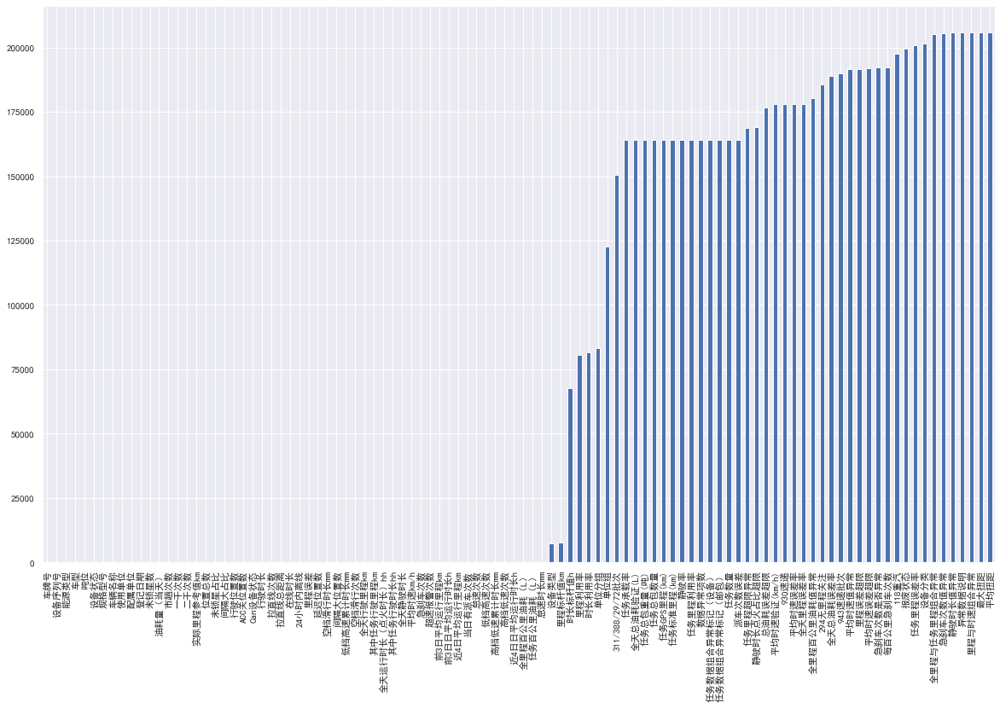

In [17]:
# nan可视化
missing = Train_data.isnull().sum()
missing = missing[missing > 0]
missing.sort_values(inplace=True)
plt.figure(figsize=(20,12))
missing.plot.bar()

In [18]:
#车牌号为空是缺失数据
print(Train_data['车牌号'].shape) #(205811,)
Train_data.loc[Train_data['车牌号'].isnull()]

(205811,)


,日期y/m/d,车牌号,配属单位,使用单位,车辆名称,规格型号,登记日期,吨位,当日有派车次数,全天行驶里程km,其中任务行驶里程km,全天运行时长（点火时长）hh,其中任务行驶时长hh,全天静驶时长,平均时速km/h,最大扭距,平均扭距,急刹车次数,超速报警次数,前3日平均运行里程km,前3日日平均运行时长h,近4日平均运行里程km,近4日日平均运行时长h,怠速次数,怠速时长mm,任务百公里油耗（L）,全里程百公里油耗（L）,高档低速次数,高档低速累计时长mm,低档高速次数,低档高速累计时长mm,空档滑行次数,空档滑行时长mm,Can设备状态,车型,单位分组,能源类型,油耗量（当天）,市趟次数,一干次数,二干次数,里程标杆值km,里程利用率,时长标杆值h,时长利用率,实际里程参考值km,位置总数,未锁星数,未锁星占比,延迟位置数,行驶位置数,间隔大位置数,ACC关位置数,间隔大占比,行驶时长,拉直线次数,拉直线总距离,设备序列号,设备类型,在线时长,设备状态,24小时内离线,里程误差,报废状态,311/388/29/72批次,294无里程关注,930速递,118重汽,每百公里急刹车次数,急刹车次数是否异常,单位组,943速递批次,异常数据说明,静驶率,任务标准里程(km),任务GPS里程(km),任务总包数量,任务总包重量(吨),任务里程利用率,任务承载率,全天里程误差率,里程误差超限,全天总油耗验证(L),全天总油耗误差率,总油耗误差超限,全里程百公里油耗值异常,平均时速验证(km/h),平均时速误差率,平均时速误差超限,平均时速值异常,静驶时长点火占比超限,静驶时长值异常,急刹车次数值异常,里程与时速组合异常,全里程与任务里程组合异常,数据异常项数,任务里程误差率,任务里程超限异常,任务数据组合异常标记（设备）,任务数据组合异常标记（邮包）,任务数量,派车次数误差,设备分类
163682,823,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
163687,823,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
163681,823,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
163683,823,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
163674,823,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
163680,823,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
163686,823,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
163678,823,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [19]:

#print(Train_data['车牌号'].shape)

In [20]:
#抽取出 '车牌号'特征 为 NaN 的样本：
Train_data[np.isnan(Train_data['油耗量（当天）'])]

,日期y/m/d,车牌号,配属单位,使用单位,车辆名称,规格型号,登记日期,吨位,当日有派车次数,全天行驶里程km,其中任务行驶里程km,全天运行时长（点火时长）hh,其中任务行驶时长hh,全天静驶时长,平均时速km/h,最大扭距,平均扭距,急刹车次数,超速报警次数,前3日平均运行里程km,前3日日平均运行时长h,近4日平均运行里程km,近4日日平均运行时长h,怠速次数,怠速时长mm,任务百公里油耗（L）,全里程百公里油耗（L）,高档低速次数,高档低速累计时长mm,低档高速次数,低档高速累计时长mm,空档滑行次数,空档滑行时长mm,Can设备状态,车型,单位分组,能源类型,油耗量（当天）,市趟次数,一干次数,二干次数,里程标杆值km,里程利用率,时长标杆值h,时长利用率,实际里程参考值km,位置总数,未锁星数,未锁星占比,延迟位置数,行驶位置数,间隔大位置数,ACC关位置数,间隔大占比,行驶时长,拉直线次数,拉直线总距离,设备序列号,设备类型,在线时长,设备状态,24小时内离线,里程误差,报废状态,311/388/29/72批次,294无里程关注,930速递,118重汽,每百公里急刹车次数,急刹车次数是否异常,单位组,943速递批次,异常数据说明,静驶率,任务标准里程(km),任务GPS里程(km),任务总包数量,任务总包重量(吨),任务里程利用率,任务承载率,全天里程误差率,里程误差超限,全天总油耗验证(L),全天总油耗误差率,总油耗误差超限,全里程百公里油耗值异常,平均时速验证(km/h),平均时速误差率,平均时速误差超限,平均时速值异常,静驶时长点火占比超限,静驶时长值异常,急刹车次数值异常,里程与时速组合异常,全里程与任务里程组合异常,数据异常项数,任务里程误差率,任务里程超限异常,任务数据组合异常标记（设备）,任务数据组合异常标记（邮包）,任务数量,派车次数误差,设备分类
64916,722,京GZ5416,北京市门头沟区邮政局,石龙支局,东南,（集团）DN5020XYZ52,2016-09-13,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2吨以下,经营单位,汽油,NaN,NaN,NaN,NaN,105.516307,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,正常,NaN,NaN,NaN,NaN,294.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
52792,718,京GZ5416,北京市门头沟区邮政局,石龙支局,东南,（集团）DN5020XYZ52,2016-09-13,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2吨以下,经营单位,汽油,NaN,NaN,NaN,NaN,105.516307,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,正常,NaN,NaN,NaN,NaN,294.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
77040,726,京GZ5416,北京市门头沟区邮政局,石龙支局,东南,（集团）DN5020XYZ52,2016-09-13,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2吨以下,经营单位,汽油,NaN,NaN,NaN,NaN,105.516307,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,正常,NaN,NaN,NaN,NaN,294.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31575,711,京GZ5416,北京市门头沟区邮政局,石龙支局,东南,（集团）DN5020XYZ52,2016-09-13,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2吨以下,经营单位,汽油,NaN,NaN,NaN,NaN,105.516307,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,正常,NaN,NaN,NaN,NaN,294.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
163682,823,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
214109,910,京GZ5416,北京市门头沟区邮政局,石龙支局,东南,（集团）DN5020XYZ52,2016-09-13,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2吨以下,NaN,汽油,NaN,NaN,NaN,NaN,103.644857,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,正常,NaN,NaN,NaN,NaN,294.0,NaN,NaN,NaN,NaN,经营单位,NaN,车辆状态：在调拨中,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
158877,822,京GZ5416,北京市门头沟区邮政局,石龙支局,东南,（集团）DN5020XYZ52,2016-09-13,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2吨以下,经营单位,汽油,NaN,NaN,NaN,NaN,103.063613,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,正常,NaN,NaN,NaN,NaN,294.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
98257,82,京GZ5416,北京市门头沟区邮政

In [168]:
## 通过Pandas对于数据进行读取 (pandas是一个很友好的数据读取函数库)
#Train_data = pd.read_csv('datalab/231784/used_car_train_20200313.csv', sep=' ')
#TestA_data = pd.read_csv('datalab/231784/used_car_testA_20200313.csv', sep=' ')


'''


path = './data/'
## 1) 载入训练集和测试集；
Train_data = pd.read_csv(path+'train.csv', sep=' ')
TestA_data = pd.read_csv(path+'testA.csv', sep=' ')

## 输出数据的大小信息
print('Train data shape:',Train_data.shape)
print('TestA data shape:',TestA_data.shape)
Train data shape: (150000, 31)
TestA data shape: (50000, 30)
    
    

#载入维度数据
x_data = datasets[[ '吨位', '当日有派车次数',
                   '全天行驶里程km', '其中任务行驶里程km', '全天运行时长（点火时长）hh', '其中任务行驶时长hh', '全天静驶时长',
                   '平均时速km/h', '最大扭距', '平均扭距', '急刹车次数', '超速报警次数', '前3日平均运行里程km', '前3日日平均运行时长h',
                   '近4日平均运行里程km', '近4日日平均运行时长h', '怠速次数', '怠速时长mm', '任务百公里油耗（L）', '全里程百公里油耗（L）'
                   , '高档低速次数', '高档低速累计时长mm', '低档高速次数', '低档高速累计时长mm', '空档滑行次数', '空档滑行时长mm',
                   'Can设备状态',  '市趟次数', '一干次数', '二干次数', '里程标杆值km',
                  '实际里程参考值km', '位置总数', '未锁星数', '延迟位置数',
                   '行驶位置数', '间隔大位置数', 'ACC关位置数',  '行驶时长', '拉直线次数', '拉直线总距离', 
                   '设备类型', '在线时长', '里程误差']]



#分割数据1/4为测试，3/4为训练数据
#载入标签数据
y_data = datasets['全里程百公里油耗（L）']

x_train,x_test,y_train,y_test = train_test_split(x_data,y_data,test_size = 0.3)
'''

"\n\n\npath = './data/'\n## 1) 载入训练集和测试集；\nTrain_data = pd.read_csv(path+'train.csv', sep=' ')\nTestA_data = pd.read_csv(path+'testA.csv', sep=' ')\n\n## 输出数据的大小信息\nprint('Train data shape:',Train_data.shape)\nprint('TestA data shape:',TestA_data.shape)\nTrain data shape: (150000, 31)\nTestA data shape: (50000, 30)\n    \n    \n\n#载入维度数据\nx_data = datasets[[ '吨位', '当日有派车次数',\n                   '全天行驶里程km', '其中任务行驶里程km', '全天运行时长（点火时长）hh', '其中任务行驶时长hh', '全天静驶时长',\n                   '平均时速km/h', '最大扭距', '平均扭距', '急刹车次数', '超速报警次数', '前3日平均运行里程km', '前3日日平均运行时长h',\n                   '近4日平均运行里程km', '近4日日平均运行时长h', '怠速次数', '怠速时长mm', '任务百公里油耗（L）', '全里程百公里油耗（L）'\n                   , '高档低速次数', '高档低速累计时长mm', '低档高速次数', '低档高速累计时长mm', '空档滑行次数', '空档滑行时长mm',\n                   'Can设备状态',  '市趟次数', '一干次数', '二干次数', '里程标杆值km',\n                  '实际里程参考值km', '位置总数', '未锁星数', '延迟位置数',\n                   '行驶位置数', '间隔大位置数', 'ACC关位置数',  '行驶时长', '拉直线次数', '拉直线总距离', \n                   '设备类型', '在线时长', '里程误差']]\n

In [387]:
#3) 数据统计信息浏览
#显示所有列
pd.set_option('display.max_columns', None)
## 通过 .describe() 可以查看数值特征列的一些统计信息
Train_data.describe()


,日期y/m/d,吨位,当日有派车次数,全天行驶里程km,其中任务行驶里程km,全天运行时长（点火时长）hh,其中任务行驶时长hh,全天静驶时长,平均时速km/h,最大扭距,平均扭距,急刹车次数,超速报警次数,前3日平均运行里程km,前3日日平均运行时长h,近4日平均运行里程km,近4日日平均运行时长h,怠速次数,怠速时长mm,任务百公里油耗（L）,全里程百公里油耗（L）,高档低速次数,高档低速累计时长mm,低档高速次数,低档高速累计时长mm,空档滑行次数,空档滑行时长mm,Can设备状态,油耗量（当天）,市趟次数,一干次数,二干次数,里程标杆值km,时长标杆值h,实际里程参考值km,位置总数,未锁星数,延迟位置数,行驶位置数,间隔大位置数,ACC关位置数,行驶时长,拉直线次数,拉直线总距离,设备序列号,在线时长,里程误差,311/388/29/72批次,294无里程关注,每百公里急刹车次数,任务标准里程(km),任务GPS里程(km),任务总包数量,任务总包重量(吨),全天总油耗验证(L),平均时速验证(km/h),数据异常项数,任务数量,派车次数误差
count,205811.000000,205800.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,0.0,0.0,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.0,198107.000000,137829.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,205751.000000,2.058000e+05,205751.000000,205751.000000,55077.000000,20199.0,13576.000000,41580.000000,41580.000000,41580.000000,41580.000000,41580.000000,27650.000000,41580.000000,41580.000000,41580.0
mean,601.878602,2.951382,0.261083,61.675001,17.949201,2.231401,0.309788,0.749324,24.553018,NaN,NaN,10.809629,0.002153,65.657200,2.399708,66.312820,2.421686,16.949040,26.781814,1.238754,6.412757,7.849075,13.017135,8.989891,2.303290,0.802169,0.408974,1.899247,6.109804,0.243756,0.017327,0.0,86.652189,8.018951,61.558075,747.476105,68.416829,6.656556,402.865707,1.049502,145.938601,1.482172,0.007810,1.149216,9.758822e+10,7.163370,-0.116926,317.223360,294.0,16.094483,21.903271,19.102848,35.937350,1.435503,6.552445,38.636195,0.903006,0.253439,0.0
std,340.883769,4.484736,1.025666,101.393448,86.736190,2.681191,1.363369,1.423747,64.044170,NaN,NaN,37.366900,0.063592,92.435146,2.479205,91.286014,2.435181,26.693323,48.179500,4.597131,11.976680,21.835651,60.573287,19.986564,5.484708,6.610330,4.232622,0.995024,17.393951,1.019861,0.142555,0.0,112.432748,4.373139,101.215945,787.535604,187.020811,48.856171,516.285545,3.394428,280.088787,1.818280,0.106609,185.266063,1.088360e+11,8.744614,6.966396,103.847038,0.0,40.260189,119.557782,101.406871,508.249126,10.224285,17.978040,96.271188,1.105727,1.028810,0.0
min,71.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,-1038.600000,29.000000,294.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
25%,95.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.0,0.000000,8.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.413133e+10,0.000000,-0.150000,311.000000,294.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,29.245283,0.000000,0.000000,0.0
50%,728.000000,1.000000,0.000000,36.100000,0.000000,1.620000,0.000000,0.000000,28.000000,NaN,NaN,0.000000,0.000000,45.300000,2.000000,46.680000,2.050000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.0,93.735901,8.000000,35.910000,598.000000,3.000000,0.000000,205.000000,0.000000,0.000000,1.170000,0.000000,0.000000,6.478150e+10,3.630000,0.000000,311.000000,294.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,35.454545,0.000000,0.000000,0.0
75%,829.000000,5.000000,0.000000,84.900000,0.000000,3.5

In [388]:
#通过数据的统计信息，可以对于数据中的特征的变化情况有一个整体的了解。
Test_data.describe()


,日期y/m/d,吨位,当日有派车次数,全天行驶里程km,其中任务行驶里程km,全天运行时长（点火时长）hh,其中任务行驶时长hh,全天静驶时长,平均时速km/h,最大扭距,平均扭距,急刹车次数,超速报警次数,前3日平均运行里程km,前3日日平均运行时长h,近4日平均运行里程km,近4日日平均运行时长h,怠速次数,怠速时长mm,任务百公里油耗（L）,全里程百公里油耗（L）,高档低速次数,高档低速累计时长mm,低档高速次数,低档高速累计时长mm,空档滑行次数,空档滑行时长mm,Can设备状态,油耗量（当天）,市趟次数,一干次数,二干次数,里程标杆值km,时长标杆值h,实际里程参考值km,位置总数,未锁星数,延迟位置数,行驶位置数,间隔大位置数,ACC关位置数,行驶时长,拉直线次数,拉直线总距离,设备序列号,在线时长,里程误差,311/388/29/72批次,294无里程关注,每百公里急刹车次数,任务标准里程(km),任务GPS里程(km),任务总包数量,任务总包重量(吨),全天总油耗验证(L),平均时速验证(km/h),数据异常项数,任务数量,派车次数误差
count,68604.000000,68599.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,0.0,0.0,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.0,66022.000000,46218.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,68581.000000,6.859900e+04,68581.000000,68581.000000,18523.000000,6811.0,4604.000000,14121.000000,14121.000000,14121.000000,14121.000000,14121.000000,9472.000000,14121.000000,14121.000000,14121.0
mean,603.783190,2.960902,0.261239,61.580143,17.416420,2.247862,0.301397,0.763855,24.416923,NaN,NaN,10.850119,0.002566,65.382390,2.409506,66.048301,2.432133,16.980855,26.899502,1.215262,6.410545,7.877838,12.810293,8.958691,2.302498,0.773421,0.385571,1.898820,6.033101,0.244776,0.016462,0.0,86.896830,8.001904,61.452027,755.913825,69.477771,6.695615,405.385209,1.045085,149.094968,1.484097,0.008005,1.062105,9.706246e+10,7.231603,-0.128116,314.796145,294.0,16.284171,21.622831,18.932144,35.340982,1.414795,6.584680,37.443728,0.918561,0.252673,0.0
std,340.348408,4.462228,1.027428,99.945735,85.046139,2.690213,1.334855,1.466691,49.520239,NaN,NaN,37.748943,0.079142,90.842812,2.480363,89.607336,2.435280,26.672134,48.552302,4.574838,11.925732,22.015003,60.079322,19.926759,5.505754,6.648696,4.007664,0.994963,16.935311,1.021909,0.139177,0.0,111.481583,4.327946,99.729854,820.882813,187.973827,48.487532,516.450252,3.406739,364.454219,1.800974,0.110185,157.550378,1.082657e+11,8.760756,7.542026,105.416951,0.0,40.665723,116.737661,100.649154,448.410758,8.973346,17.770554,73.270012,1.114174,0.992980,0.0
min,71.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,-1037.000000,29.000000,294.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
25%,95.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.0,0.000000,8.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.413133e+10,0.000000,-0.160000,311.000000,294.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,28.960000,0.000000,0.000000,0.0
50%,728.000000,1.000000,0.000000,37.100000,0.000000,1.650000,0.000000,0.000000,29.000000,NaN,NaN,0.000000,0.000000,45.300000,2.000000,46.880000,2.050000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.0,93.735901,8.000000,36.920000,612.000000,3.000000,0.000000,210.000000,0.000000,1.000000,1.180000,0.000000,0.000000,6.478150e+10,3.720000,0.000000,311.000000,294.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,35.246269,0.000000,0.000000,0.0
75%,829.000000,5.000000,0.000000,85.000000,0.000000,3.550000,0.000000,1.020000,40.000000,NaN,NaN,0.000000

In [389]:
#Step 3: 数据分析（EDA）
#1) 提取数值类型特征列名
numerical_cols = Train_data.select_dtypes(exclude = 'object').columns
print(numerical_cols)

Index(['日期y/m/d', '登记日期', '吨位', '当日有派车次数', '全天行驶里程km', '其中任务行驶里程km',
       '全天运行时长（点火时长）hh', '其中任务行驶时长hh', '全天静驶时长', '平均时速km/h', '最大扭距', '平均扭距',
       '急刹车次数', '超速报警次数', '前3日平均运行里程km', '前3日日平均运行时长h', '近4日平均运行里程km',
       '近4日日平均运行时长h', '怠速次数', '怠速时长mm', '任务百公里油耗（L）', '全里程百公里油耗（L）', '高档低速次数',
       '高档低速累计时长mm', '低档高速次数', '低档高速累计时长mm', '空档滑行次数', '空档滑行时长mm', 'Can设备状态',
       '油耗量（当天）', '市趟次数', '一干次数', '二干次数', '里程标杆值km', '时长标杆值h', '实际里程参考值km',
       '位置总数', '未锁星数', '延迟位置数', '行驶位置数', '间隔大位置数', 'ACC关位置数', '行驶时长', '拉直线次数',
       '拉直线总距离', '设备序列号', '在线时长', '里程误差', '311/388/29/72批次', '294无里程关注',
       '每百公里急刹车次数', '任务标准里程(km)', '任务GPS里程(km)', '任务总包数量', '任务总包重量(吨)',
       '全天总油耗验证(L)', '平均时速验证(km/h)', '数据异常项数', '任务数量', '派车次数误差'],
      dtype='object')


In [390]:
#查看非数值的变量名称
categorical_cols = Train_data.select_dtypes(include = 'object').columns
categorical_cols = list(categorical_cols)
print(categorical_cols,'\n')

['车牌号', '配属单位', '使用单位', '车辆名称', '规格型号', '车型', '单位分组', '能源类型', '里程利用率', '时长利用率', '未锁星占比', '间隔大占比', '设备类型', '设备状态', '24小时内离线', '报废状态', '930速递', '118重汽', '急刹车次数是否异常', '单位组', '943速递批次', '异常数据说明', '静驶率', '任务里程利用率', '任务承载率', '全天里程误差率', '里程误差超限', '全天总油耗误差率', '总油耗误差超限', '全里程百公里油耗值异常', '平均时速误差率', '平均时速误差超限', '平均时速值异常', '静驶时长点火占比超限', '静驶时长值异常', '急刹车次数值异常', '里程与时速组合异常', '全里程与任务里程组合异常', '任务里程误差率', '任务里程超限异常', '任务数据组合异常标记（设备）', '任务数据组合异常标记（邮包）', '设备分类'] 



In [391]:
Train_data[numerical_cols].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 205811 entries, 8168 to 257633
Data columns (total 60 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   日期y/m/d          205811 non-null  int64         
 1   登记日期             205800 non-null  datetime64[ns]
 2   吨位               205800 non-null  float64       
 3   当日有派车次数          205751 non-null  float64       
 4   全天行驶里程km         205751 non-null  float64       
 5   其中任务行驶里程km       205751 non-null  float64       
 6   全天运行时长（点火时长）hh   205751 non-null  float64       
 7   其中任务行驶时长hh       205751 non-null  float64       
 8   全天静驶时长           205751 non-null  float64       
 9   平均时速km/h         205751 non-null  float64       
 10  最大扭距             0 non-null       float64       
 11  平均扭距             0 non-null       float64       
 12  急刹车次数            205751 non-null  float64       
 13  超速报警次数           205751 non-null  float64       
 14  前3日平均运行里程km      

In [392]:
from datetime import datetime
Train_data['date_parsed'] = pd.to_datetime(Train_data['日期y/m/d'],format = '%m%d')
Train_data = Train_data.drop('日期y/m/d',axis = 1)
#修改数据采集时间的格式（训练数据）
Train_data['date_parsed'] = Train_data['date_parsed'].apply(lambda x : x.strftime('2020-%m-%d')).astype('datetime64')
Train_data['date_parsed']

8168     2020-07-03
82073    2020-07-28
96842    2020-08-01
44150    2020-07-15
23330    2020-07-08
183745   2020-08-30
210214   2020-09-09
27258    2020-07-09
182366   2020-08-30
8409     2020-07-03
186856   2020-08-31
259569   2020-09-26
25468    2020-07-09
83335    2020-07-28
159450   2020-08-22
223367   2020-09-13
240175   2020-09-19
60653    2020-07-21
266618   2020-09-28
157351   2020-08-21
212668   2020-09-09
118760   2020-08-09
78300    2020-07-26
58906    2020-07-20
79997    2020-07-27
147810   2020-08-18
267048   2020-09-28
63870    2020-07-22
185942   2020-08-31
175876   2020-08-28
244554   2020-09-20
244338   2020-09-20
84302    2020-07-28
1917     2020-07-01
259884   2020-09-26
49490    2020-07-17
202634   2020-09-06
61325    2020-07-21
95800    2020-08-01
164809   2020-08-24
9668     2020-07-04
144094   2020-08-17
134456   2020-08-14
109228   2020-08-06
176688   2020-08-28
11068    2020-07-04
83343    2020-07-28
124668   2020-08-11
83042    2020-07-28
83561    2020-07-28


In [393]:
from datetime import datetime
Test_data['date_parsed'] = pd.to_datetime(Test_data['日期y/m/d'],format = '%m%d')
Test_data = Test_data.drop('日期y/m/d',axis = 1)
#修改数据采集时间的格式（测试数据）
Test_data['date_parsed'] = Test_data['date_parsed'].apply(lambda x : x.strftime('2020-%m-%d')).astype('datetime64')
Test_data['date_parsed']

9441     2020-07-04
263583   2020-09-27
238425   2020-09-18
10287    2020-07-04
98451    2020-08-02
57499    2020-07-19
27615    2020-07-10
196016   2020-09-04
77996    2020-07-26
229572   2020-09-15
38904    2020-07-13
155069   2020-08-21
250518   2020-09-22
193021   2020-09-03
32638    2020-07-11
173226   2020-08-27
78062    2020-07-26
132073   2020-08-13
81519    2020-07-27
102999   2020-08-03
39521    2020-07-14
133418   2020-08-14
100589   2020-08-03
249871   2020-09-22
244930   2020-09-21
148766   2020-08-19
229799   2020-09-15
245619   2020-09-21
9086     2020-07-03
93620    2020-07-31
10967    2020-07-04
194894   2020-09-03
229100   2020-09-15
135500   2020-08-14
8560     2020-07-03
234076   2020-09-17
48009    2020-07-16
219687   2020-09-12
223566   2020-09-13
253644   2020-09-24
3352     2020-07-02
45184    2020-07-15
59820    2020-07-20
240444   2020-09-19
38612    2020-07-13
95513    2020-08-01
200558   2020-09-05
71355    2020-07-24
210879   2020-09-09
271048   2020-09-29


In [394]:
#Train_data['日期y/m/d']
#日期处理好后重新提取数值类型特征列名
numerical_cols = Train_data.select_dtypes(exclude = 'object').columns
print(numerical_cols)
Train_data[numerical_cols].info()

Index(['登记日期', '吨位', '当日有派车次数', '全天行驶里程km', '其中任务行驶里程km', '全天运行时长（点火时长）hh',
       '其中任务行驶时长hh', '全天静驶时长', '平均时速km/h', '最大扭距', '平均扭距', '急刹车次数', '超速报警次数',
       '前3日平均运行里程km', '前3日日平均运行时长h', '近4日平均运行里程km', '近4日日平均运行时长h', '怠速次数',
       '怠速时长mm', '任务百公里油耗（L）', '全里程百公里油耗（L）', '高档低速次数', '高档低速累计时长mm', '低档高速次数',
       '低档高速累计时长mm', '空档滑行次数', '空档滑行时长mm', 'Can设备状态', '油耗量（当天）', '市趟次数',
       '一干次数', '二干次数', '里程标杆值km', '时长标杆值h', '实际里程参考值km', '位置总数', '未锁星数',
       '延迟位置数', '行驶位置数', '间隔大位置数', 'ACC关位置数', '行驶时长', '拉直线次数', '拉直线总距离',
       '设备序列号', '在线时长', '里程误差', '311/388/29/72批次', '294无里程关注', '每百公里急刹车次数',
       '任务标准里程(km)', '任务GPS里程(km)', '任务总包数量', '任务总包重量(吨)', '全天总油耗验证(L)',
       '平均时速验证(km/h)', '数据异常项数', '任务数量', '派车次数误差', 'date_parsed'],
      dtype='object')
<class 'pandas.core.frame.DataFrame'>
Int64Index: 205811 entries, 8168 to 257633
Data columns (total 60 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   登记日期   

In [395]:
Train_data[categorical_cols].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 205811 entries, 8168 to 257633
Data columns (total 43 columns):
 #   Column          Non-Null Count   Dtype 
---  ------          --------------   ----- 
 0   车牌号             205800 non-null  object
 1   配属单位            205800 non-null  object
 2   使用单位            205800 non-null  object
 3   车辆名称            205800 non-null  object
 4   规格型号            205800 non-null  object
 5   车型              205800 non-null  object
 6   单位分组            122836 non-null  object
 7   能源类型            205800 non-null  object
 8   里程利用率           124802 non-null  object
 9   时长利用率           124015 non-null  object
 10  未锁星占比           205751 non-null  object
 11  间隔大占比           205751 non-null  object
 12  设备类型            198327 non-null  object
 13  设备状态            205800 non-null  object
 14  24小时内离线         205751 non-null  object
 15  报废状态            6309 non-null    object
 16  930速递           27947 non-null   object
 17  118重汽           8052 non-n

In [396]:
#查看非数值变量里种类
for i in categorical_cols:
    print(i,':',set(Train_data[i]),'\n\n')

车牌号 : {nan, '京AHL007', '京Q83XN7', '京QZ36U1', '京Q60YY1', '京JEH860', '京Q17WD5', '京AGL262', '京ABX962', '京AGD539', '京PS7U78', '京AS5975', '京AJR328', '京QW79K1', '京Q386N8', '京AKT221', '京AR9188', '京ADX206', '京ANC053', '京QQ98F0', '京AN3741', '京AMC958', '京Q821V3', '京Q18ZR2', '京AGS302', '京Q91ZE0', '京Q502L9', '京AKE839', '京AJY272', '京Q91XK6', '京QQ92F1', '京AMP035', '京QB2F93', '京AEM900', '京AHW898', '京Q87XD2', '京QX05W2', '京Q79XX7', '京AFD128', '京AJX289', '京MFB992', '京AJA350', '京Q6S0M7', '京FFR183', '京AS5936', '京ALW537', '京MU0016', '京FEG936', '京PS2A32', '京AHE212', '京Q58XT7', '京Q0YZ13', '京AMD913', '京M37370', '京ADL5981', '京Q318Y7', '京JA7036', '京LE8836', '京ANF753', '京AHP627', '京QX19W9', '京QA8Q32', '京AHQ330', '京ADH6880', '京Q3U7C2', '京Q333H8', '京Q82XD7', '京AKR850', '京PS1A35', '京Q825V5', '京P00B37', '京HEF869', '京QS09D6', '京LE8858', '京ACR781', '京Q787J0', '京QN5G21', '京AW9771', '京AMN823', '京ACA633', '京GPU023', '京GXX013', '京LE8817', '京QW65K7', '京QN5C71', '京QX15X9', '京MN6710', '京AKB707', '京CBL453', '京Q95ZD5', '京Q319Y

里程利用率 : {nan, 0, 0.75, 1.857902241384295, 1.226411620843578, 0.25, 0.8125, 1.1875, 0.90625, 0.5625, 1.8125, 1.375, 0.34375, 1.625, 1, 1.0625, 0.8011146437776057, 0.5062, 0.2780452205976493, 0.8187, 0.6312, 0.7562, 1.360696317311714, 1.2562, 1.0062, 1.4437, 1.3187, 0.791, 1.9437, 0.498180822628337, 0.233852808194355, 1.5, 0.875, 1.5625, 0.15625, 0.7856511689519015, 0.375, 0.6374, 0.21875, 1.017129719068564, 1.25, 0.913529384658912, 0.8874, 2.0749, 1.1374, 0.8953910062150753, 1.0124, 0.7360845255220992, 0.0343365086542349, 0.7686, 0.8936, 0.5811, 0.03733894886386226, '39.88%', 1.0811, 1.0186, 1.2061, 2.0625, 1.1436, 1.944507442548123, 1.457, 1.00423414783792, 0.152760407361086, 0.1582815084464642, '75.84%', 0.2719437693525811, '20.94%', 1.3373, 1.0248, 0.6014074795693435, 1.1498, 2.37192657271848, 1.3998, 1.3435, 1.031, 1.7185, 1.5935, 1.2185, 0.07467789772772453, 0.09394359774626086, 0.8337664920771726, 0.6151948098843305, 1.7872, 1.2247, 1.2872, 0.742667472204969, 0.875947909662839, 0.

930速递 : {nan, '930速递'} 


118重汽 : {nan, '118重汽', '         a'} 


急刹车次数是否异常 : {nan, '否', '是'} 


单位组 : {nan, '其他', '经营单位', '专业局', '运输单位'} 


943速递批次 : {nan, '943速递'} 


异常数据说明 : {nan, '疑似车辆速度传感器故障', '疑似接长线', '车辆状态：在调拨中'} 


静驶率 : {nan, 0, 1, 0.25, 0.375, 0.1875, 0.5, 0.625, 0.1814, 0.8064, 0.9375, 0.2828, '13.87%', 0.1609, 0.125, '20.80%', 0.3156, 0.3484, '12.88%', 0.3812, 0.4765, 0.5093, '12.12%', 0.3218, 0.0625, 0.0808, 0.3125, 0.875, 0.75, '61.73%', 0.2329, '21.46%', 0.1494, 0.7686, '19.11%', '17.20%', 0.8936, '8.71%', '42.31%', '23.97%', '48.22%', '45.37%', '37.84%', 0.2302, 0.2241, '17.29%', '9.93%', 0.1555, 0.2119, 0.218, '18.29%', 0.1433, 0.1616, '17.70%', '34.19%', '37.50%', 0.3408, '36.36%', 0.1091, 0.0427, '57.14%', '28.94%', '15.33%', '8.90%', '32.01%', 0.0549, '24.36%', '27.48%', '46.38%', 0.2988, 0.3293, 0.1235, 0.1982, 0.061, 0.1174, '8.82%', 0.2424, 0.3674, 0.2927, '36.31%', '9.54%', 0.92, 0.67, '20.15%', '39.34%', 0.6731, '38.51%', '27.93%', 0.3934, '8.12%', '19.48%', 0

平均时速误差率 : {nan, 0, '1.36%', 1, '-0.19%', -0.0141, 0.0061, -0.008, '0.01%', -0.0221, '-1.29%', '30.00%', '1.89%', '0.95%', 0.0122, '2.16%', -0.0019, '-1.65%', '-0.86%', -0.016, '0.96%', '-1.58%', 0.0667, 0.0183, 0.0042, -0.0099, '-2.03%', '-1.71%', -0.024, '1.55%', '-0.85%', '-0.87%', '-2.02%', '3.28%', '-0.69%', 0.0103, '2.23%', '2.12%', -0.0038, '-0.96%', -0.0179, '1.80%', 0.0023, 0.0164, -0.0118, '0.61%', '0.13%', -0.04, '-0.20%', 0.0084, '20.00%', -0.0198, -0.0057, '2.14%', 0.0145, '-0.44%', '-0.35%', '-1.05%', -0.0137, 0.0004, '-1.42%', '2.07%', '-1.82%', 0.0206, 0.0065, -0.0076, '0.16%', '-0.21%', '-0.80%', '-2.82%', '2.18%', 0.0126, -0.0015, '-1.36%', -0.0156, '0.97%', '-0.99%', 0.0046, '-1.07%', 0.0187, -0.0095, -0.0236, '1.23%', 0.0107, '0.77%', '-1.20%', -0.0034, -0.0175, 0.0168, 0.0027, -0.0114, '1.14%', -0.0255, 0.0229, '-1.34%', 0.0088, '1.22%', -0.0053, '1.12%', '1.06%', '1.33%', '-0.68%', '0.56%', '0.35%', 0.0149, 0.0008, '-1.13%', -0.0133, '1.34%', '1.01%', 0.0069, 0.021

急刹车次数值异常 : {nan, '时长大于等于15次'} 


里程与时速组合异常 : {nan, 'Can设备版本需升级，OBD车速改为GPS车速', '疑似GPS设备跳时导致，需现场检修'} 


全里程与任务里程组合异常 : {nan, '未按照实际情况派车'} 


任务里程误差率 : {nan, '3.40%', '80.08%', '26.44%', '74.63%', '4.15%', '29.98%', '27.85%', '88.71%', '5.59%', '45.24%', '53.52%', '28.98%', '60.98%', '-60.24%', '26.94%', '29.91%', '67.66%', '47.52%', '91.92%', '73.64%', '5.41%', '-60.09%', '-37.56%', '56.50%', '18.33%', '4.49%', '58.52%', '38.48%', '96.41%', '98.53%', '2.97%', '1.76%', '30.68%', '28.10%', '38.58%', '59.84%', '-66.11%', '56.89%', '74.04%', '35.20%', '-56.64%', '99.02%', '24.10%', '80.91%', '-54.88%', '95.75%', '57.94%', '48.98%', '91.46%', '27.21%', '-53.63%', '-55.00%', '24.93%', '39.55%', '72.65%', '-75.00%', '-63.22%', '-109.11%', '68.95%', '-203.53%', '27.25%', '19.68%', '50.51%', '99.09%', '48.88%', '66.08%', '86.19%', '11.19%', '90.37%', '96.93%', '82.80%', '62.16%', '78.19%', '61.12%', '52.50%', '78.67%', '-43.46%', '-99.28%', '-55.38%', '-102.55%', '9.38%', '87.66%', '33.43%', '60.

In [420]:
#由于数据特征可以分为 三种不同类型的特征，分别为时间特征，类别特征和数值类型特征 , 我们对于不同特征进行分类别处理。
date_features = ['登记日期', 'date_parsed']

categorical_features = ['设备分类 ', '任务数据组合异常标记（邮包）', '任务数据组合异常标记（设备）', '任务里程超限异常', '全里程与任务里程组合异常', '里程与时速组合异常', '急刹车次数值异常', '静驶时长值异常',
                        '静驶时长点火占比超限','平均时速值异常','平均时速误差超限','全里程百公里油耗值异常','总油耗误差超限','里程误差超限','异常数据说明','943速递批次',
                       '单位组','急刹车次数是否异常','118重汽','930速递','报废状态','24小时内离线','设备状态','设备类型','能源类型','单位分组','车型','规格型号',
                       '车辆名称','使用单位','配属单位','车牌号']

numeric_features = [] 
for i in categorical_cols:
    if i not in  categorical_features:
        numeric_features.append(i)


In [398]:
a = Train_data['登记日期']
a

8168     2019-03-25
82073    2008-10-07
96842    2020-01-06
44150    2010-12-23
23330    2019-03-21
183745   2019-01-30
210214   2007-12-26
27258    2020-01-06
182366   2007-12-27
8409     2019-10-18
186856   2008-09-26
259569   2019-05-15
25468    2012-09-12
83335    2018-09-27
159450   2008-09-26
223367   2007-03-15
240175   2012-09-10
60653    2006-05-02
266618   2007-12-12
157351   2016-11-28
212668   2020-01-07
118760   2016-12-24
78300    2018-10-19
58906    2017-12-15
79997    2008-10-28
147810   2019-03-25
267048   2015-11-17
63870    2008-10-16
185942   2019-03-27
175876   2017-03-02
244554   2020-01-06
244338   2007-11-22
84302    2019-05-10
1917     2016-11-14
259884   2007-04-23
49490    2007-04-25
202634   2020-01-07
61325    2008-09-27
95800    2008-09-28
164809   2008-01-08
9668     2014-12-23
144094   2017-12-15
134456   2018-09-27
109228   2007-12-10
176688   2018-09-27
11068    2013-07-29
83343    2016-12-24
124668   2007-12-12
83042    2019-07-18
83561    2008-10-14


In [400]:
#首先对于时间特征进行处理:
from tqdm import tqdm

def date_proc(x):
#    print(type(x))
    m = int(x[5:7])
    if m == 0:
        m = 1
#    print(m)
    return x[:4] + '-' + str(m) + '-' + x[8:]


def num_to_date(df,date_cols):
    for f in tqdm(date_cols):
#        df[f] = pd.to_datetime(df[f].astype('str').apply(date_proc))   #????出了问题
        df[f + '_year'] = df[f].dt.year
        df[f + '_month'] = df[f].dt.month
        df[f + '_day'] = df[f].dt.day
        df[f + '_dayofweek'] = df[f].dt.dayofweek
    return df
Train_data2 = num_to_date(Train_data,date_features)

100%|████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  8.00it/s]


In [342]:
'''
def date_proc(x):
#    print(type(x))
    m = int(x[5:7])
    
    if m == 0:
        m = 1
    print(m)
    return x[:4] + '-' + str(m) + '-' + x[8:]
x = '2020/03/12'
x = str(x)
date_proc(x)
'''
Train_data['登记日期_year']

242298    2008.0
26585     2019.0
31980     2017.0
258271    2018.0
154833    2007.0
270475    2017.0
220154    2019.0
224137    2014.0
157950    2018.0
91161     2018.0
59282     2017.0
228272    2014.0
32698     2019.0
264127    2017.0
17553     2019.0
53091     2015.0
109258    2016.0
94290     2018.0
54044     2017.0
257612    2007.0
118133    2020.0
137346    2016.0
135833    2019.0
45409     2020.0
174046    2011.0
117422    2014.0
235144    2019.0
147519    2015.0
44392     2014.0
212924    2007.0
118078    2020.0
14806     2020.0
189447    2014.0
125355    2018.0
253400    2020.0
230760    2016.0
82020     2008.0
216381    2018.0
135107    2011.0
90556     2020.0
76590     2017.0
13894     2018.0
142279    2020.0
21242     2007.0
96786     2020.0
153163    2017.0
49089     2017.0
189100    2019.0
156938    2007.0
156366    2014.0
125644    2007.0
104854    2018.0
270642    2019.0
36693     2008.0
97512     2014.0
72522     2018.0
171784    2019.0
147140    2014.0
238013    2017

In [401]:
#首先对于时间特征进行处理:
from tqdm import tqdm

def date_proc(x):
#    print(type(x))
    m = int(x[5:7])
    if m == 0:
        m = 1
#    print(m)
    return x[:4] + '-' + str(m) + '-' + x[8:]


def num_to_date(df,date_cols):
    for f in tqdm(date_cols):
#        df[f] = pd.to_datetime(df[f].astype('str').apply(date_proc))   #????出了问题
        df[f + '_year'] = df[f].dt.year
        df[f + '_month'] = df[f].dt.month
        df[f + '_day'] = df[f].dt.day
        df[f + '_dayofweek'] = df[f].dt.dayofweek
    return df
Test_data2 = num_to_date(Test_data,date_features)

100%|████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 21.99it/s]


Index(['车牌号', '配属单位', '使用单位', '车辆名称', '规格型号', '吨位', '当日有派车次数', '全天行驶里程km',
       '其中任务行驶里程km', '全天运行时长（点火时长）hh',
       ...
       '派车次数误差', '设备分类', '登记日期_year', '登记日期_month', '登记日期_day',
       '登记日期_dayofweek', 'date_parsed_year', 'date_parsed_month',
       'date_parsed_day', 'date_parsed_dayofweek'],
      dtype='object', length=109)

<Figure size 432x288 with 0 Axes>

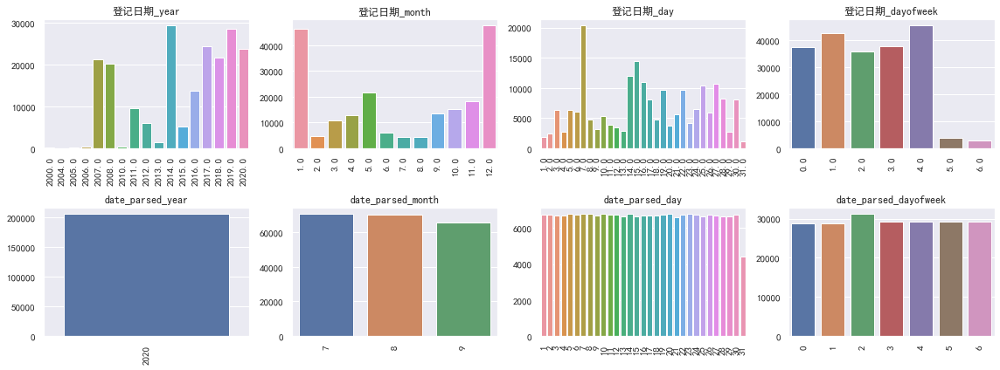

In [402]:
plt.figure()
plt.figure(figsize=(16, 6))
i = 1
for f in date_features:
    for col in ['year', 'month', 'day', 'dayofweek']:
        plt.subplot(2, 4, i)
        i += 1
        v = Train_data[f + '_' + col].value_counts()
        fig = sns.barplot(x=v.index, y=v.values)
        for item in fig.get_xticklabels():
            item.set_rotation(90)
        plt.title(f + '_' + col)
plt.tight_layout()
plt.show()


<Figure size 432x288 with 0 Axes>

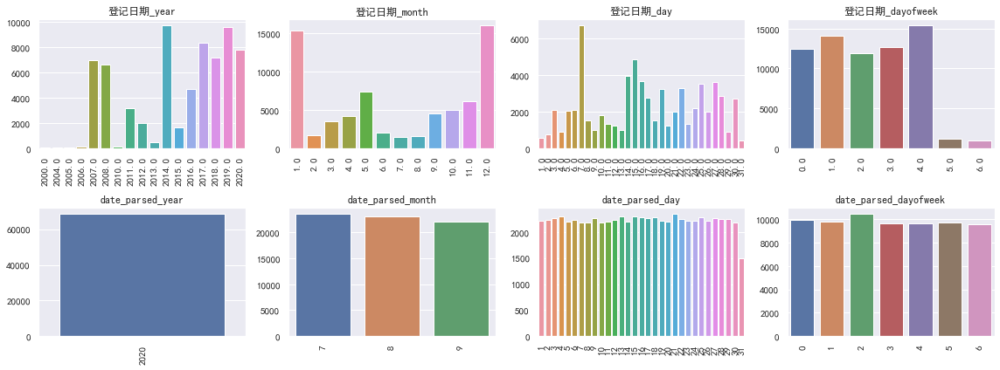

In [404]:
plt.figure()
plt.figure(figsize=(16, 6))
i = 1
for f in date_features:
    for col in ['year', 'month', 'day', 'dayofweek']:
        plt.subplot(2, 4, i)
        i += 1
        v = Test_data[f + '_' + col].value_counts()
        fig = sns.barplot(x=v.index, y=v.values)
        for item in fig.get_xticklabels():
            item.set_rotation(90)
        plt.title(f + '_' + col)
plt.tight_layout()
plt.show()


<Figure size 432x288 with 0 Axes>

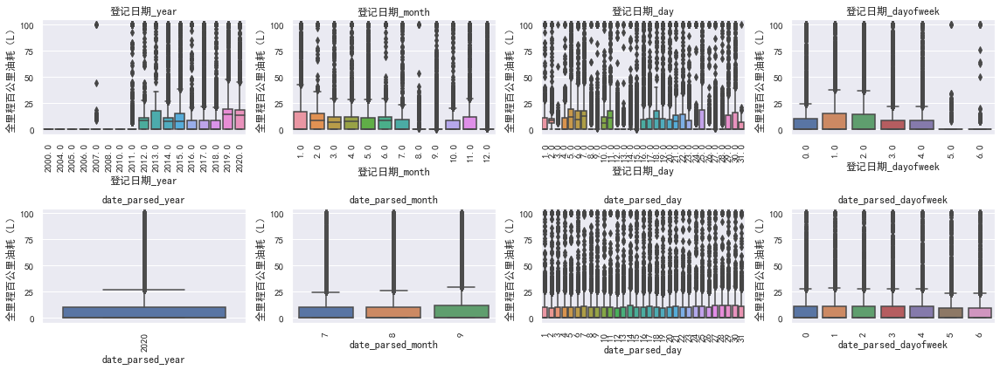

In [406]:
plt.figure()
plt.figure(figsize=(16, 6))
i = 1
for f in date_features:
    for col in ['year', 'month', 'day', 'dayofweek']:
        plt.subplot(2, 4, i)
        i += 1
        fig = sns.boxplot(x=Train_data[f + '_' + col], y=Train_data['全里程百公里油耗（L）'])
        for item in fig.get_xticklabels():
            item.set_rotation(90)
        plt.title(f + '_' + col)
plt.tight_layout()
plt.show()


In [416]:
#从上面时间分析更新数据特征，'date_parsed_year'没有价值
date_features = ['登记日期_year', '登记日期_month', '登记日期_day',
       '登记日期_dayofweek',  'date_parsed_month',
       'date_parsed_day', 'date_parsed_dayofweek']

In [425]:
Train_data.columns

Index(['车牌号', '配属单位', '使用单位', '车辆名称', '规格型号', '登记日期', '吨位', '当日有派车次数',
       '全天行驶里程km', '其中任务行驶里程km',
       ...
       '设备分类', 'date_parsed', '登记日期_year', '登记日期_month', '登记日期_day',
       '登记日期_dayofweek', 'date_parsed_year', 'date_parsed_month',
       'date_parsed_day', 'date_parsed_dayofweek'],
      dtype='object', length=111)

In [1]:
Train_data['设备分类'].nunique()

NameError: name 'Train_data' is not defined

In [445]:
for i in categorical_features:
    print(i)
    print(Train_data['i'].nunique())

设备分类 


KeyError: '设备分类 '

In [435]:
#类别特征处理：
#对于类别类型的特征，首先这里第一步进行类别数量统计
from scipy.stats import mode

def sta_cate(df,cols):
    sta_df = pd.DataFrame(columns = ['column','nunique','miss_rate','most_value','most_value_counts','max_value_counts_rate'])
    for col in cols:
        count = df[col].count()
        nunique = df[col].nunique()
        miss_rate = (df.shape[0] - count) / df.shape[0]
        most_value = df[col].value_counts().index[0]
        most_value_counts = df[col].value_counts().values[0]
        max_value_counts_rate = most_value_counts / df.shape[0]
        
        sta_df = sta_df.append({'column':col,'nunique':nunique,'miss_rate':miss_rate,'most_value':most_value,
                                'most_value_counts':most_value_counts,'max_value_counts_rate':max_value_counts_rate},ignore_index=True)
    return sta_df


In [436]:
sta_cate(Train_data,categorical_features)

KeyError: '设备分类 '